In [36]:
import torch
from torchvision import transforms, datasets

data_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

data_dir = 'data/EuroSAT_RGB/'

train_data = datasets.ImageFolder(root=data_dir, transform=data_transform)

train_size = int(0.8 * len(train_data))
test_size = len(train_data) - train_size
train_set, test_set = torch.utils.data.random_split(train_data, [train_size, test_size])

train_loader = torch.utils.data.DataLoader(train_set, batch_size=64, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_set, batch_size=64)


In [37]:
import torch.nn as nn

class SimpleCNN(nn.Module):
    def __init__(self):
        super(SimpleCNN, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.fc1 = nn.Linear(16 * 64 * 64, 256)
        self.fc2 = nn.Linear(256, 11)  # 11 classes

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = x.view(-1, 16 * 64 * 64)  # Flattening
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

model = SimpleCNN()


In [38]:
import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [39]:
import torch.nn.functional as F  

num_epochs = 10

for epoch in range(num_epochs):
    model.train()  
    for images, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

    
    model.eval()  
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in test_loader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    print(f'Epoch [{epoch+1}/{num_epochs}], Test Accuracy: {(100 * correct / total):.2f}%')


Epoch [1/10], Test Accuracy: 63.54%
Epoch [2/10], Test Accuracy: 61.30%
Epoch [3/10], Test Accuracy: 70.72%
Epoch [4/10], Test Accuracy: 71.83%
Epoch [5/10], Test Accuracy: 70.57%
Epoch [6/10], Test Accuracy: 73.63%
Epoch [7/10], Test Accuracy: 73.44%
Epoch [8/10], Test Accuracy: 74.76%
Epoch [9/10], Test Accuracy: 72.89%
Epoch [10/10], Test Accuracy: 73.09%


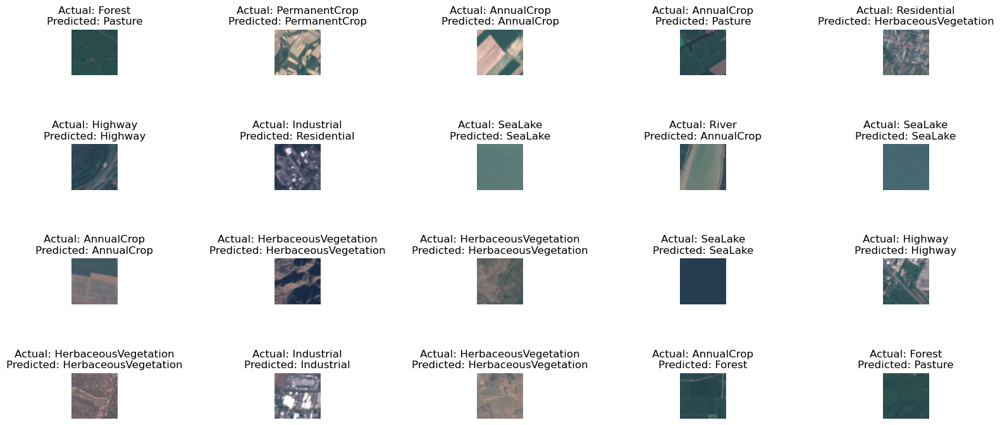

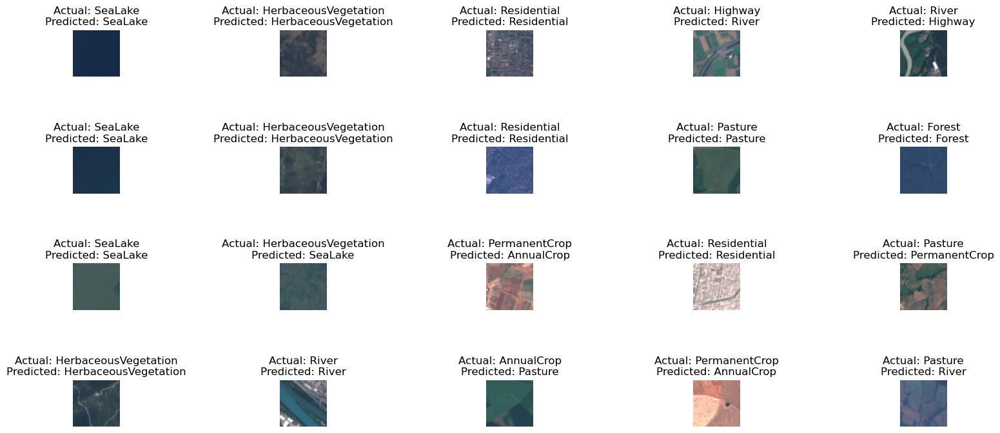

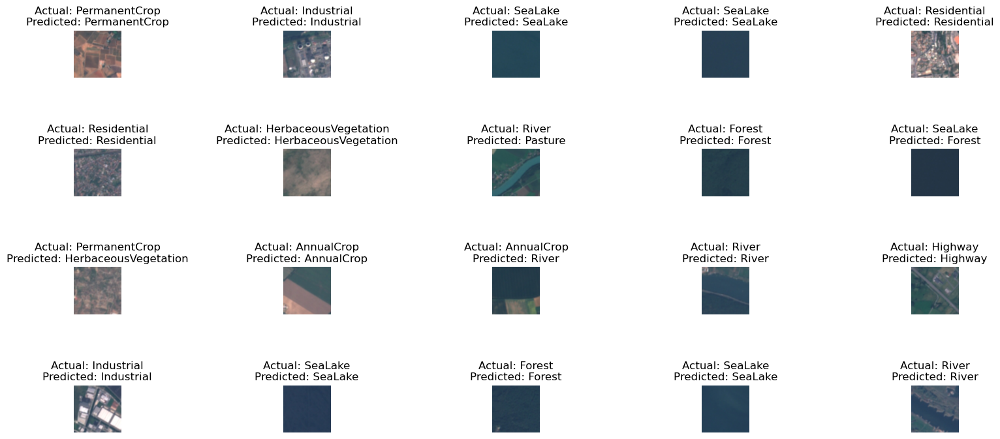

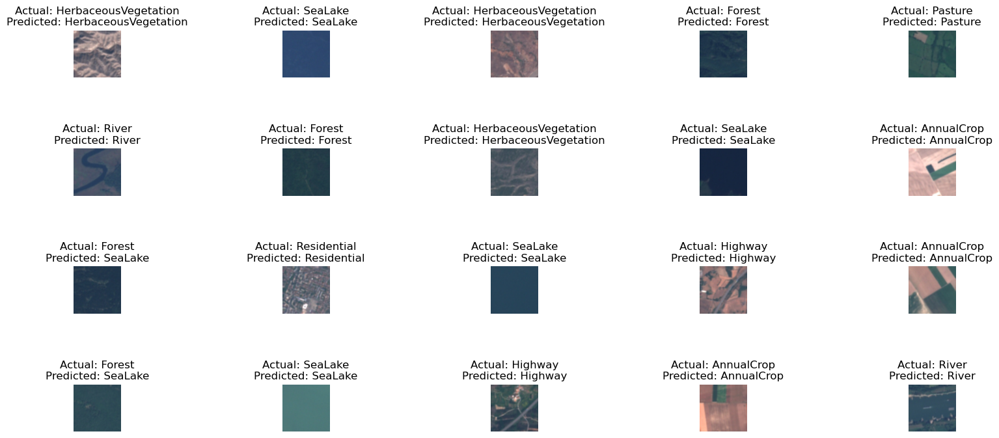

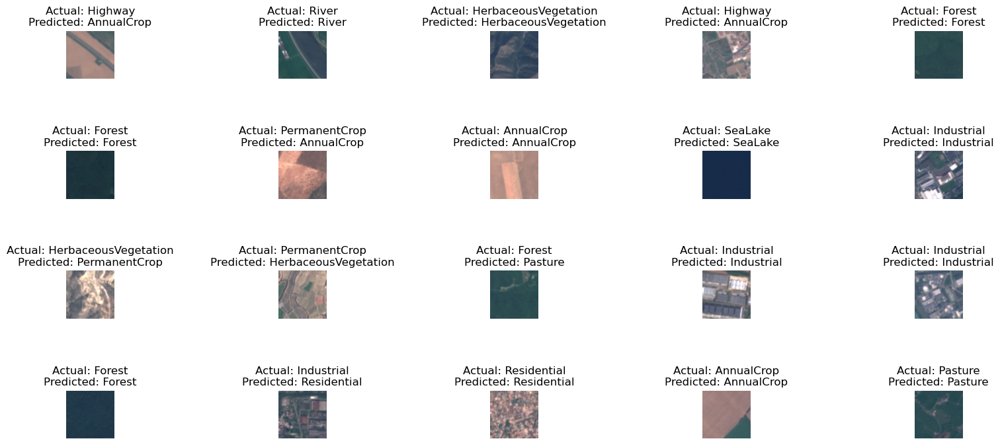

...

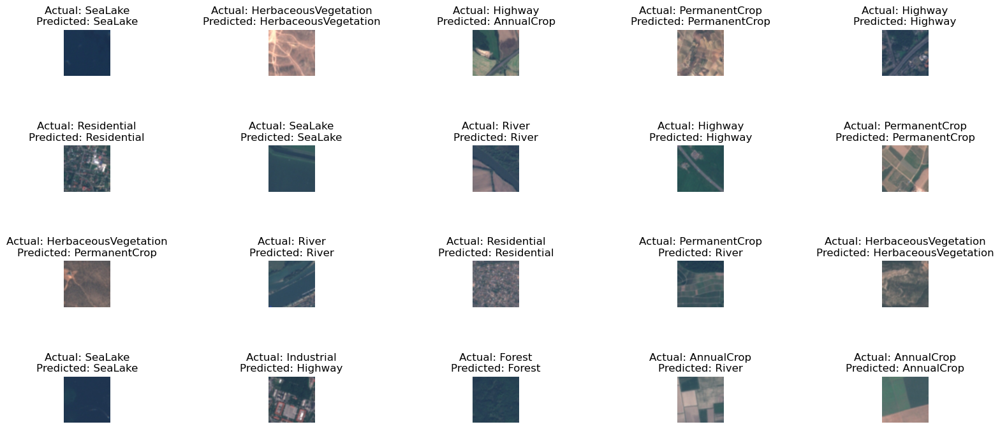

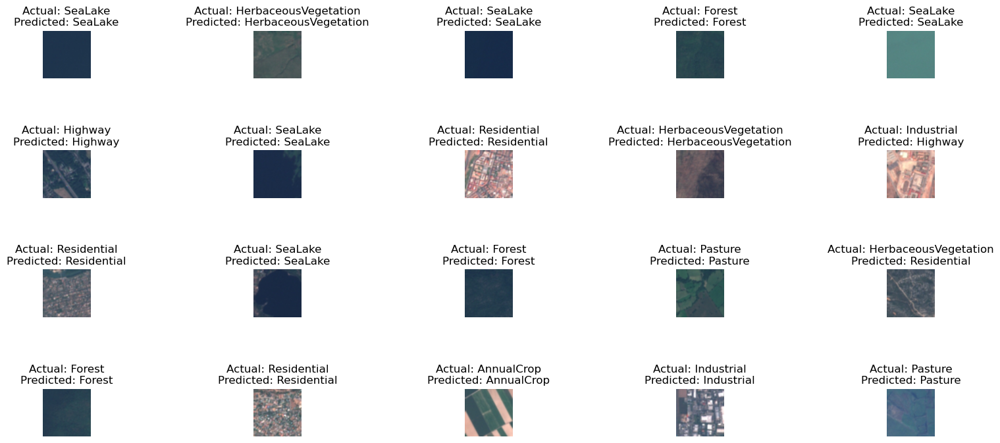

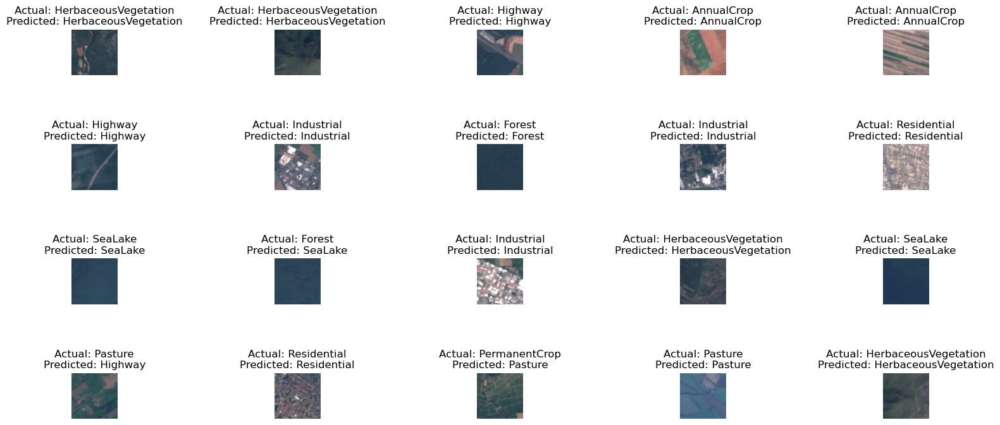

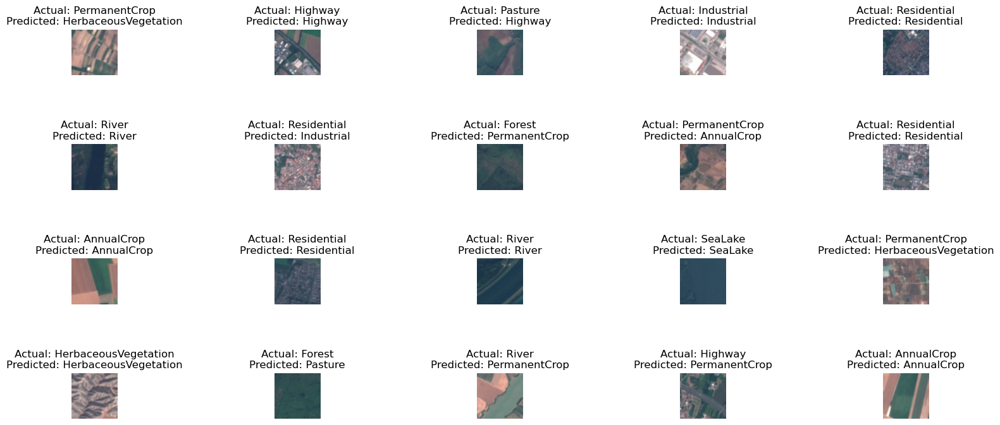

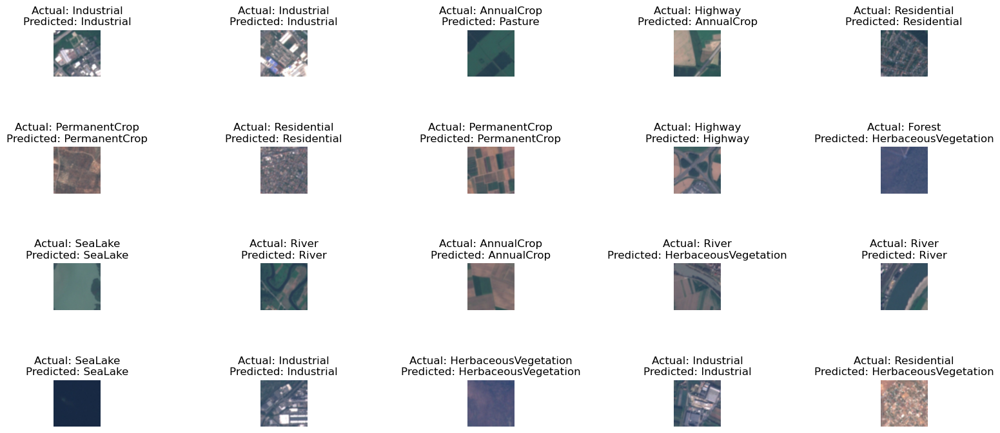

[[523   4   7   5   0   9  20   0  10  23]
 [  0 446  11   0   0  50   1   0   0  95]
 [ 42   4 397  12   5  17  59  19   9  38]
 [ 94   2  23 239   5   9  25  25  55   7]
 [  2   0   6  12 378   0   5  63   6   0]
 [ 26   1   7   9   0 290  20   0   9  39]
 [109   0  62  14   2  18 287   2  16   4]
 [  2   0  42  33  24   0  10 492   2   0]
 [ 46   9  19  69   1  22   7   3 321  18]
 [  3  14   2   1   0   6   0   0   3 574]]


In [40]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix

model.eval()

all_labels = []  
all_predicted = []  

with torch.no_grad():
    for images, labels in test_loader:
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        all_labels.extend(labels.numpy())  
        all_predicted.extend(predicted.numpy())  

        fig = plt.figure(figsize=(20, 8))
        fig.subplots_adjust(hspace=1.5)

        num_images = len(images)
        num_columns = 4

        for idx in range(20):
            ax = fig.add_subplot(4, 5, idx + 1)
            ax.imshow(np.transpose(images[idx], (1, 2, 0)))
            ax.set_title(f'Actual: {train_data.classes[labels[idx]]}\nPredicted: {train_data.classes[predicted[idx]]}')
            ax.axis('off')

        plt.show()

conf_matrix = confusion_matrix(all_labels, all_predicted)
print(conf_matrix)


In [41]:
conf_matrix = confusion_matrix(all_labels, all_predicted)
print(conf_matrix)

[[523   4   7   5   0   9  20   0  10  23]
 [  0 446  11   0   0  50   1   0   0  95]
 [ 42   4 397  12   5  17  59  19   9  38]
 [ 94   2  23 239   5   9  25  25  55   7]
 [  2   0   6  12 378   0   5  63   6   0]
 [ 26   1   7   9   0 290  20   0   9  39]
 [109   0  62  14   2  18 287   2  16   4]
 [  2   0  42  33  24   0  10 492   2   0]
 [ 46   9  19  69   1  22   7   3 321  18]
 [  3  14   2   1   0   6   0   0   3 574]]


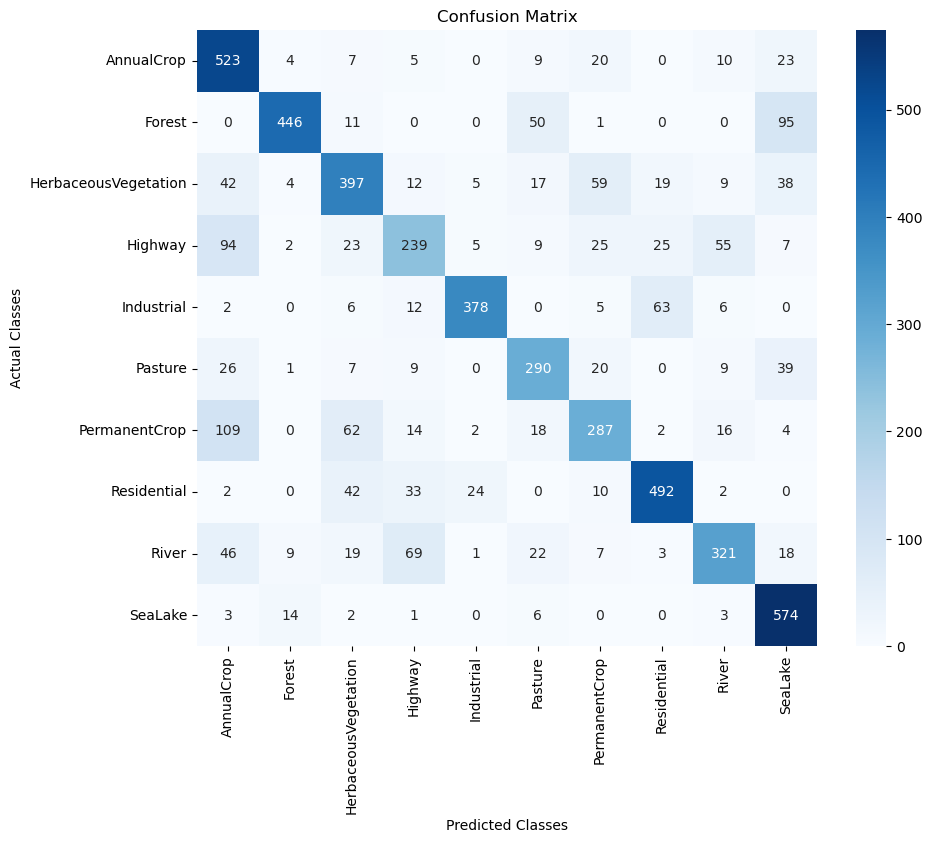

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns

class_labels = ['AnnualCrop', 'Forest', 'HerbaceousVegetation', 'Highway', 'Industrial', 'Pasture', 'PermanentCrop', 'Residential', 'River', 'SeaLake']

conf_matrix = conf_matrix

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Classes')
plt.ylabel('Actual Classes')
plt.title('Confusion Matrix')
plt.show()


AnnualCrop: The model correctly predicted 523 instances of "AnnualCrop" as "AnnualCrop." It misclassified 4 instances of "AnnualCrop" as "Forest," 7 as "HerbaceousVegetation," 5 as "Highway," and so on.

Forest: The model correctly predicted 446 instances of "Forest" as "Forest." It misclassified 11 instances of "Forest" as "HerbaceousVegetation," 50 as "Pasture," 1 as "PermanentCrop," and so on.

HerbaceousVegetation: The model correctly predicted 397 instances of "HerbaceousVegetation" as "HerbaceousVegetation." It misclassified 42 instances of "HerbaceousVegetation" as "AnnualCrop," 12 as "HerbaceousVegetation," 5 as "Industrial," and so on.

Highway: The model correctly predicted 239 instances of "Highway" as "Highway." It misclassified 94 instances of "Highway" as "AnnualCrop," 2 as "Forest," 23 as "HerbaceousVegetation," and so on.

Industrial: The model correctly predicted 378 instances of "Industrial" as "Industrial." It misclassified 6 instances of "Industrial" as "AnnualCrop," 12 as "Highway," 5 as "Industrial," and so on.

Pasture: The model correctly predicted 290 instances of "Pasture" as "Pasture." It misclassified 26 instances of "Pasture" as "AnnualCrop," 1 as "Forest," 7 as "HerbaceousVegetation," and so on.

PermanentCrop: The model correctly predicted 287 instances of "PermanentCrop" as "PermanentCrop." It misclassified 109 instances of "PermanentCrop" as "AnnualCrop," 62 as "HerbaceousVegetation," 14 as "Highway," and so on.

Residential: The model correctly predicted 492 instances of "Residential" as "Residential." It misclassified 2 instances of "Residential" as "AnnualCrop," 42 as "HerbaceousVegetation," 33 as "Highway," and so on.

River: The model correctly predicted 321 instances of "River" as "River." It misclassified 46 instances of "River" as "AnnualCrop," 9 as "Forest," 19 as "HerbaceousVegetation," and so on.

SeaLake: The model correctly predicted 574 instances of "SeaLake" as "SeaLake." It misclassified 3 instances of "SeaLake" as "AnnualCrop," 14 as "Forest," 2 as "HerbaceousVegetation," and so on.